<a href="https://colab.research.google.com/github/merzechan/Predicting-Diseases-in-Chinese-Cabbage/blob/main/Capstone2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import os, datetime
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import Image, display
import re
import itertools
#!pip install split-folders
#import splitfolders

from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import confusion_matrix

from skimage.segmentation import mark_boundaries

import tensorflow as tf
import tensorflow_hub as hub
import tensorboard as tb
import tensorflow_datasets as tfds
from tensorflow.keras import layers, utils
from tensorflow.keras import preprocessing
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import cv2

!pip install lime
from lime import lime_image

RANDOM_STATE = np.random.RandomState(0)

from google.colab import drive
drive.mount("/content/gdrive")

     |████████████████████████████████| 275 kB 5.3 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=7fd9985cbefb724468f75f4c22463f00d8710535c03531dbf7603a5cf1d7d7c6
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime
Mounted at /content/gdrive


In [2]:
TRAIN_DIR = '/content/gdrive/My Drive/bok_choy/train/'
TEST_DIR = '/content/gdrive/My Drive/bok_choy/test/'

TRAIN_PATH="/content/gdrive/MyDrive/bok_choy/manual_split/manual_split/train"
VAL_PATH="/content/gdrive/MyDrive/bok_choy/manual_split/manual_split/val"

In [3]:
train_set = preprocessing.image_dataset_from_directory(TRAIN_PATH)
len(train_set)

Found 2306 files belonging to 3 classes.


73

In [4]:
""" This is set of default values """

# Define image size
IMG_SIZE = 224

# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of our model
OUTPUT_SHAPE = len(preprocessing.image_dataset_from_directory(TRAIN_PATH,
                                                   image_size=(IMG_SIZE,IMG_SIZE)).class_names)

# Setup model URL from TensorFlow Hub
MobileNetV2 = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"
EfficientNetB0 = "https://tfhub.dev/tensorflow/efficientnet/b0/classification/1"
MobileNetV3 = "https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5"
InceptionV3 = "https://tfhub.dev/google/imagenet/inception_v3/classification/5"
EfficientNetB5 = 'https://tfhub.dev/tensorflow/efficientnet/b5/classification/1' #img_size=456
EfficientNetB6 = 'https://tfhub.dev/tensorflow/efficientnet/b6/classification/1' #img_size=528

# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_auc",
                                                  patience=4)

# Tensorboard Logs path
LOGS = "/content/gdrive/My Drive/bok_choy/logs"

# Setup TensorBoard
file_writer = tf.summary.create_file_writer(LOGS)


Found 2306 files belonging to 3 classes.


In [5]:
df = pd.read_csv("/content/gdrive/My Drive/bok_choy/train.csv")
print(df.describe())
print(df.head())

       has_backmoth  has_leafminer   has_mildew
count   2878.000000    2878.000000  2878.000000
mean       0.623002       0.115705     0.261293
std        0.484719       0.319927     0.439415
min        0.000000       0.000000     0.000000
25%        0.000000       0.000000     0.000000
50%        1.000000       0.000000     0.000000
75%        1.000000       0.000000     1.000000
max        1.000000       1.000000     1.000000
          id  has_backmoth  has_leafminer  has_mildew
0  Backmoth1             1              0           0
1  Backmoth2             1              0           0
2  Backmoth3             1              0           0
3  Backmoth4             1              0           0
4  Backmoth5             1              0           0


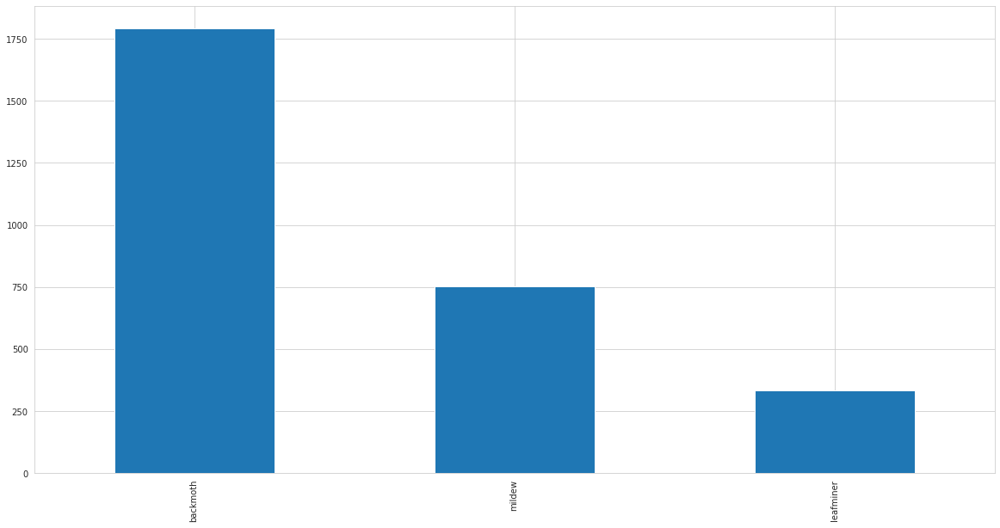

In [6]:
# Create function to undummify categorical labels
def undummify(df, prefix_sep="_"):
    cols2collapse = {
        item.split(prefix_sep)[0]: (prefix_sep in item) for item in df.columns
    }
    series_list = []
    for col, needs_to_collapse in cols2collapse.items():
        if needs_to_collapse:
            undummified = (
                df.filter(like=col)
                .idxmax(axis=1)
                .apply(lambda x: x.split(prefix_sep, maxsplit=1)[1])
                .rename(col)
            )
            series_list.append(undummified)
        else:
            series_list.append(df[col])
    undummified_df = pd.concat(series_list, axis=1)
    return undummified_df

sns.set_style('whitegrid')
undummify(df)['has'].value_counts().plot.bar(figsize=(20, 10))

In [7]:
filenames=[]
labels=[]
for root, dirs, files in os.walk(TRAIN_PATH, topdown=True):
  for name in files:
      filenames.append(os.path.join(root, name))
      labels.append(name)

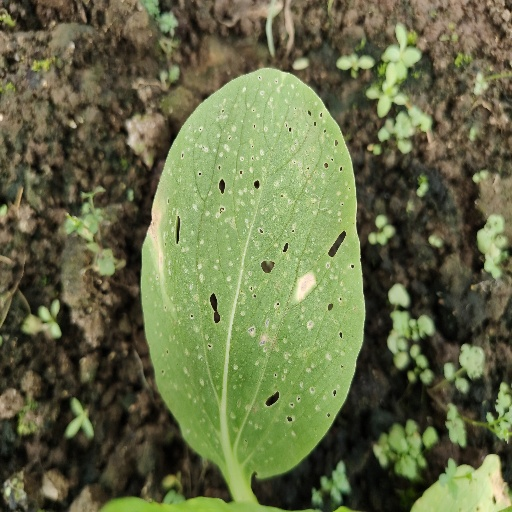

In [8]:
display(Image(filenames[123]))
print(filenames[123])

/content/gdrive/MyDrive/bok_choy/manual_split/manual_split/train/mildew/Mildew265.jpg


In [9]:
train_data = tf.keras.utils.image_dataset_from_directory(TRAIN_PATH,
                                                   image_size=(IMG_SIZE,IMG_SIZE),
                                                   seed=123
                                                   )
val_data = tf.keras.utils.image_dataset_from_directory(VAL_PATH,
                                                   image_size=(IMG_SIZE,IMG_SIZE),
                                                   seed=123
                                                   )
train_data.class_names

Found 2306 files belonging to 3 classes.
Found 572 files belonging to 3 classes.


['backmoth', 'leafminer', 'mildew']

In [10]:
unique_disease=np.array(train_data.class_names)
unique_disease

array(['backmoth', 'leafminer', 'mildew'], dtype='<U9')

In [11]:
# Set number of images to use for experimenting
NUM_IMAGES = 3000 #@param {type:"slider", min:500, max:3000, step:500}

In [12]:
NUM_EPOCHS = 50 #@param {type:"slider", min:10, max:100, step:10}

In [37]:
# Function to check GPU availability
def gpu_check():
  return print("GPU", "available (YESSS!!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")



# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns the image into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image



# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the assosciated label,
  processes the image and reutrns a typle of (image, label).
  """
  image = process_image(image_path)
  return image, label





# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples (this also turns the iamge path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

# Create a function for viewing images in a data batch
def show_15_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
  """
  # Setup the figure
  fig, ax = plt.subplots(3,5,figsize=(20,10))
  ax = ax.ravel()
  # Loop through 25 (for displaying 25 images)
  for i in range(15):
    # Display an image 
    ax[i].imshow(images[i].astype(np.uint8))
    # Add the image label as the title
    ax[i].title.set_text(unique_disease[labels[i].argmax()])
    # Turn the grid lines off
    ax[i].axis("off");
  fig.tight_layout()




# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MobileNetV3,image_size=IMG_SIZE):
  print("Building model with:", max(model_url.split('/')[4:]))

   # Setup the model layers
  model = Sequential([
    layers.Resizing(IMG_SIZE,IMG_SIZE),
    hub.KerasLayer(model_url), # Layer 1 (input layer)
    layers.Dense(units=OUTPUT_SHAPE,
                 activation="softmax",
                 name = "output_layer") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["AUC"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

# Create a function to build a TensorBoard callback
def create_tensorboard_callback(model_name):
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join(LOGS,
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S")+model_name)
  return tf.keras.callbacks.TensorBoard(logdir)


# Build a function to train and return a trained model
def train_model(model,model_name):
  
  # Trains a given model and returns the trained version.

  # Create training image generator
  train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=50,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    vertical_flip=True
    )

  train_generator = train_datagen.flow_from_directory(
    TRAIN_PATH ,
    target_size=(IMG_SIZE,IMG_SIZE),
    batch_size= BATCH_SIZE,
    class_mode="categorical"
    )
  
  # Create validation image generator
  val_datagen = ImageDataGenerator(
    rescale=1./255,
    )

  val_generator = val_datagen.flow_from_directory(
    VAL_PATH,
    target_size=(IMG_SIZE,IMG_SIZE),
    batch_size= BATCH_SIZE,
    class_mode="categorical"
    )


  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback(model_name)

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_generator,
            steps_per_epoch= len(preprocessing.image_dataset_from_directory(TRAIN_PATH)),
            epochs=NUM_EPOCHS,
            validation_data=val_generator,
            validation_steps= len(preprocessing.image_dataset_from_directory(VAL_PATH)),
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model



def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_disease[np.argmax(prediction_probabilities)]


def unbatchify(data,str_labels=True):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  if str_labels:
    for image, label in data.unbatch().as_numpy_iterator():
      images.append(image)
      labels.append(unique_disease[np.argmax(label)])
  else:
    for image, label in data.unbatch().as_numpy_iterator():
      images.append(image)
      labels.append(label)
  return images, labels


def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image.astype(np.uint8))
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"
  
  # Change plot title to be predicted, probability of prediction and truth label
  plt.title("{} {:2.0f}% {}".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)
  

def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_disease[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass


# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/gdrive/My Drive/bok_choy/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path


# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, 
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

  

def make_confusion_matrix(y_true, y_pred, classes=None, figsize=(10, 10), text_size=15, norm=False, savefig=False): 
  """Makes a labelled confusion matrix comparing predictions and ground truth labels.

  If classes is passed, confusion matrix will be labelled, if not, integer class values
  will be used.

  Args:
    y_true: Array of truth labels (must be same shape as y_pred).
    y_pred: Array of predicted labels (must be same shape as y_true).
    classes: Array of class labels (e.g. string form). If `None`, integer labels are used.
    figsize: Size of output figure (default=(10, 10)).
    text_size: Size of output figure text (default=15).
    norm: normalize values or not (default=False).
    savefig: save confusion matrix to file (default=False).
  
  Returns:
    A labelled confusion matrix plot comparing y_true and y_pred.

  Example usage:
    make_confusion_matrix(y_true=test_labels, # ground truth test labels
                          y_pred=y_preds, # predicted labels
                          classes=class_names, # array of class label names
                          figsize=(15, 15),
                          text_size=10)
  """  
  # Create the confustion matrix
  cm = confusion_matrix(y_true, y_pred)
  cm_norm = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis] # normalize it
  n_classes = cm.shape[0] # find the number of classes we're dealing with

  # Plot the figure and make it pretty
  sns.set_style('white')
  fig, ax = plt.subplots(figsize=figsize)
  cax = ax.matshow(cm, cmap='GnBu') # colors will represent how 'correct' a class is, darker == better
  fig.colorbar(cax)

  # Are there a list of classes?
  if classes:
    labels = classes
  else:
    labels = np.arange(cm.shape[0])
  
  # Label the axes
  ax.set(title="Confusion Matrix",
         xlabel="Predicted label",
         ylabel="True label",
         xticks=np.arange(n_classes), # create enough axis slots for each class
         yticks=np.arange(n_classes), 
         xticklabels=labels, # axes will labeled with class names (if they exist) or ints
         yticklabels=labels)
  
  # Make x-axis labels appear on bottom
  ax.xaxis.set_label_position("bottom")
  ax.xaxis.tick_bottom()

  ### Added: Rotate xticks for readability & increase font size (required due to such a large confusion matrix)
  plt.xticks(rotation=70, fontsize=text_size)
  plt.yticks(fontsize=text_size)

  # Set the threshold for different colors
  threshold = (cm.max() + cm.min()) / 2.

  # Plot the text on each cell
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    if norm:
      plt.text(j, i, f"{cm[i, j]} ({cm_norm[i, j]*100:.1f}%)",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)
    else:
      plt.text(j, i, f"{cm[i, j]}",
              horizontalalignment="center",
              color="white" if cm[i, j] > threshold else "black",
              size=text_size)

  # Save the figure to the current working directory
  if savefig:
    fig.savefig("confusion_matrix.png")

# Batch Predict
def batch_predict(preds,validation=val_data, num_rows=5, num_cols=2,i_multiplier=20):
  # Make predictions on the validation data (not used to train on)
  val_images, val_labels = unbatchify(validation)
  
  # Subplot predictions
  num_images = num_rows*num_cols
  plt.figure(figsize=(10*num_cols, 5*num_rows))
  for i in range(num_images):
    plt.subplot(num_rows, 2*num_cols, 2*i+1)
    plot_pred(prediction_probabilities=preds,
              labels=val_labels,
              images=val_images,
              n=i+i_multiplier)
    plt.subplot(num_rows, 2*num_cols, 2*i+2)
    plot_pred_conf(prediction_probabilities=preds,
                  labels=val_labels,
                  n=i+i_multiplier)
  plt.tight_layout(h_pad=1.0)
  plt.show()


# LIME Explainer
def LIME_explanation(model,img,n_samples=1000):
  explainer = lime_image.LimeImageExplainer()
  explanation = explainer.explain_instance(img.numpy().astype('double'), model.predict,  
                                         top_labels=3, hide_color=0, num_samples=n_samples)

  temp_1, mask_1 = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
  temp_2, mask_2 = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,15))
  ax1.imshow(mark_boundaries(temp_1, mask_1))
  ax2.imshow(mark_boundaries(temp_2, mask_2))
  ax1.axis('off')
  ax2.axis('off')

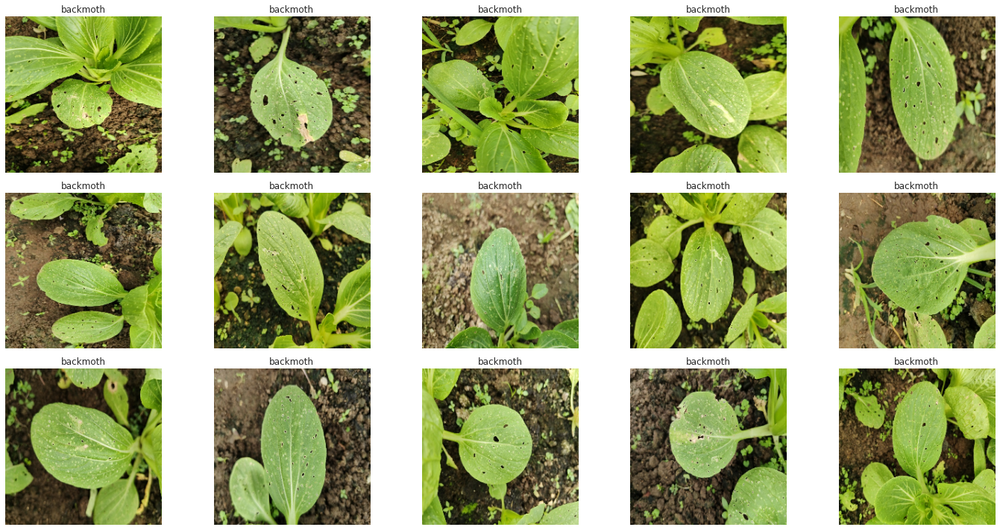

In [14]:
# Now let's visualize the data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_15_images(train_images, train_labels)

In [15]:
# Load TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir /content/gdrive/My\ Drive/bok_choy/logs

<IPython.core.display.Javascript object>

In [16]:
# Load in the full model
model_baseline = load_model('/content/gdrive/MyDrive/bok_choy/models/20211203-15221638544946-MobileNetV2_baseline.h5')

Loading saved model from: /content/gdrive/MyDrive/bok_choy/models/20211203-15221638544946-MobileNetV2_baseline.h5


In [17]:
baseline_pred = model_baseline.predict(val_data)

In [18]:
# Load in the full model
model_imagegen_efficientnetb5 = load_model('/content/gdrive/My Drive/bok_choy/models/20211207-12281638880132-EfficientNetB5_imagegen.h5')

Loading saved model from: /content/gdrive/My Drive/bok_choy/models/20211207-12281638880132-EfficientNetB5_imagegen.h5


In [19]:
b5_pred = model_imagegen_efficientnetb5.predict(val_data)

In [20]:
# Load in the full model
model_imagegen_efficientnetb6 = load_model('/content/gdrive/My Drive/bok_choy/models/20211207-16001638892806-EfficientNetB6_imagegen.h5')

Loading saved model from: /content/gdrive/My Drive/bok_choy/models/20211207-16001638892806-EfficientNetB6_imagegen.h5


In [21]:
b6_pred = model_imagegen_efficientnetb6.predict(val_data)

In [22]:
# Create lists of corresponding filenames and labels
filenames=[]
labels=[]
for root, dirs, files in os.walk(VAL_PATH, topdown=True):
  for name in files:
      filenames.append(os.path.join(root, name))
      labels.append(name)
labels = [re.split(r'(\d+)', s)[0].lower() for s in labels]

In [23]:
# Sampling an image to feed for LIME explainer
sample_img, sample_label = get_image_label(filenames[123], labels[123])

In [24]:
# Create validation images and labels for confusion matrix
val_images, val_labels = unbatchify(val_data,str_labels=False)

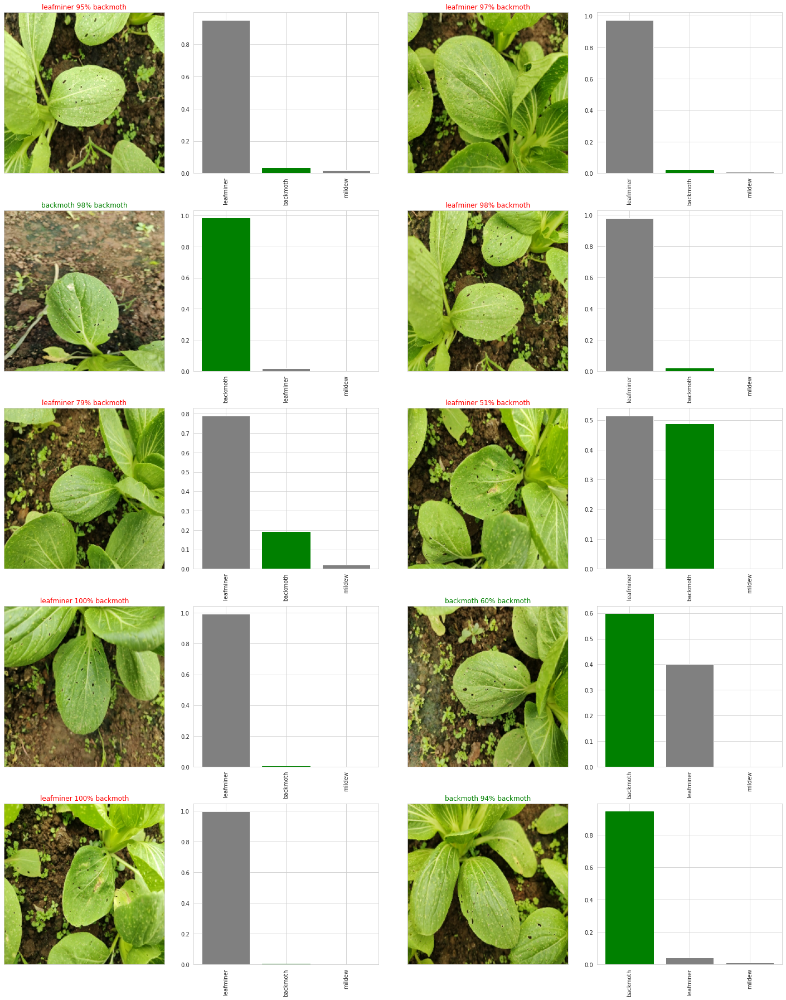

In [25]:
batch_predict(baseline_pred)

  0%|          | 0/1000 [00:00<?, ?it/s]

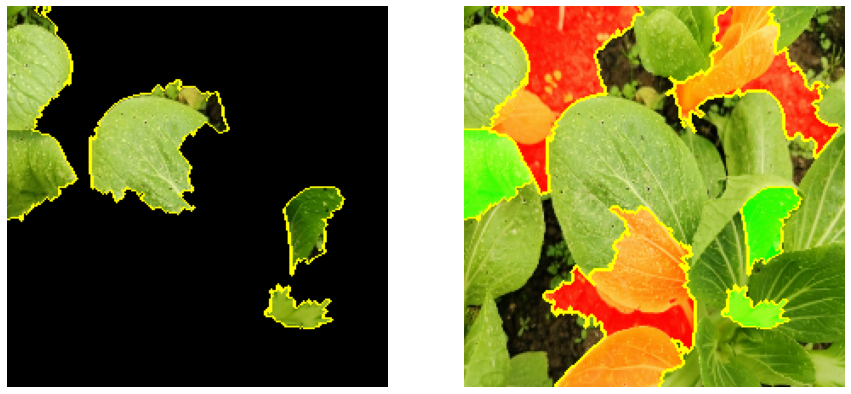

In [26]:
LIME_explanation(model_baseline,sample_img)

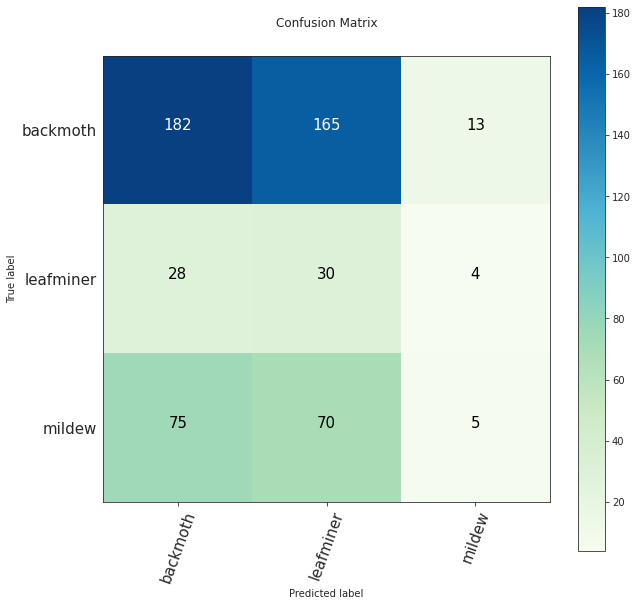

In [27]:
make_confusion_matrix(val_labels, baseline_pred.argmax(axis=1), classes=val_data.class_names, figsize=(10, 10), text_size=15, norm=False, savefig=False)

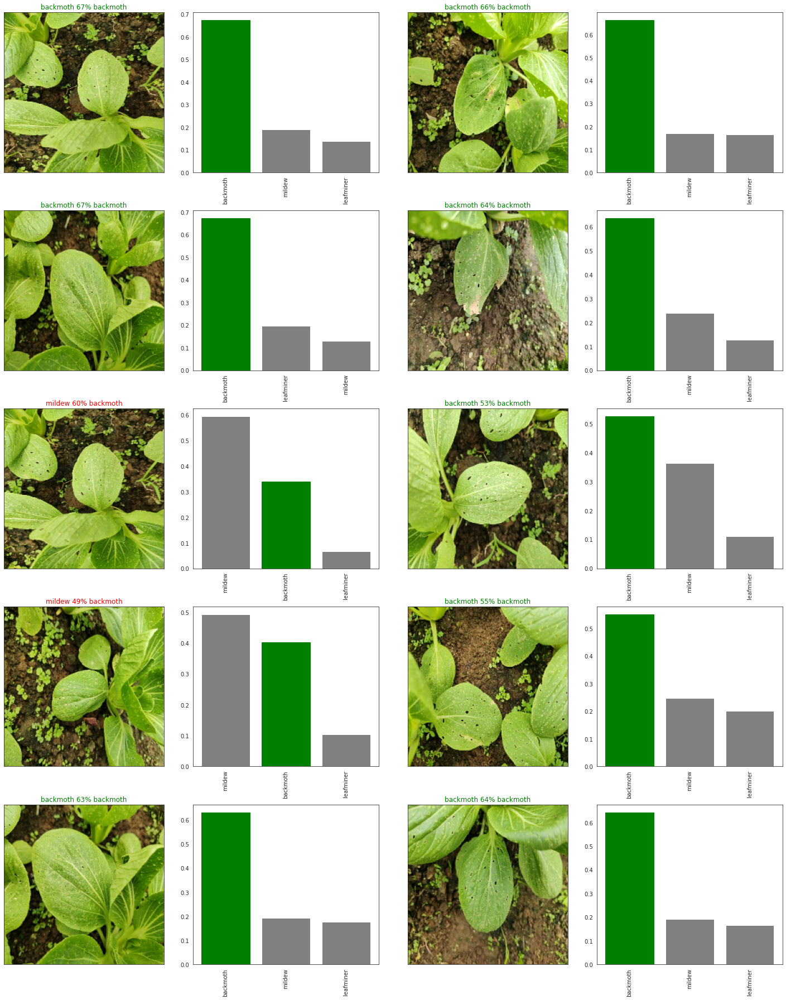

In [28]:
batch_predict(b5_pred)

  0%|          | 0/1000 [00:00<?, ?it/s]

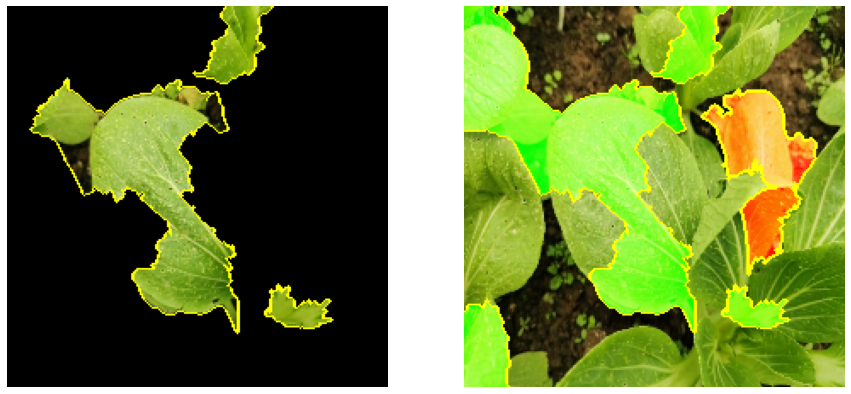

In [29]:
LIME_explanation(model_imagegen_efficientnetb5,sample_img)

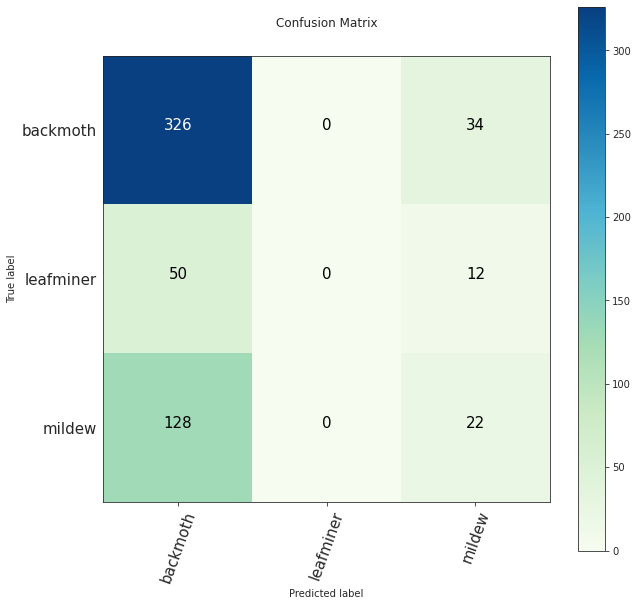

In [30]:
make_confusion_matrix(val_labels, b5_pred.argmax(axis=1), classes=val_data.class_names, figsize=(10, 10), text_size=15, norm=False, savefig=False)

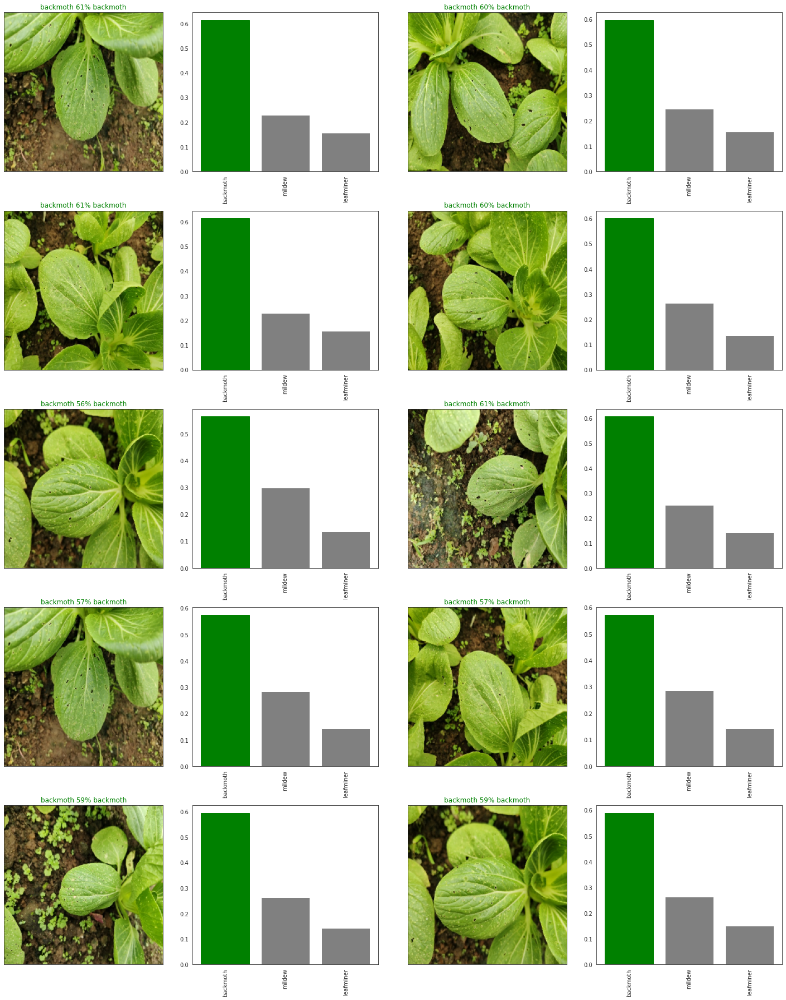

In [31]:
batch_predict(b6_pred)

  0%|          | 0/1000 [00:00<?, ?it/s]

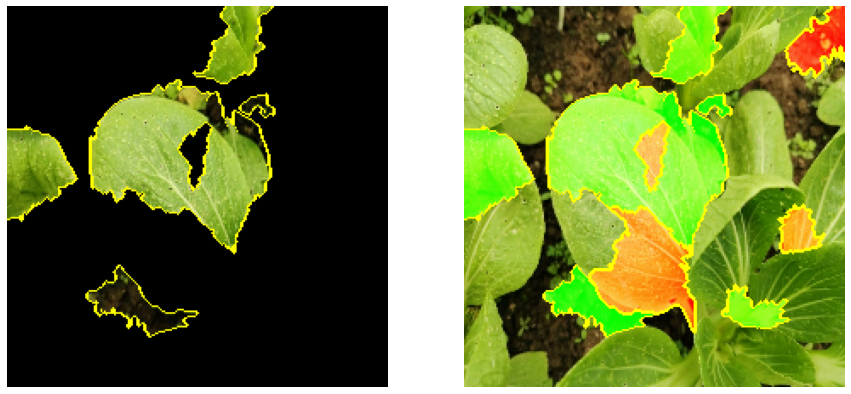

In [32]:
LIME_explanation(model_imagegen_efficientnetb6,sample_img)

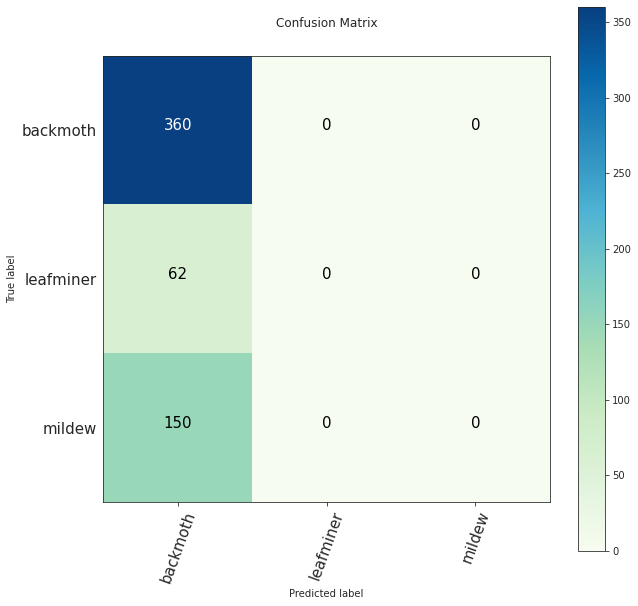

In [33]:
make_confusion_matrix(val_labels, b6_pred.argmax(axis=1), classes=val_data.class_names, figsize=(10, 10), text_size=15, norm=False, savefig=False)

In [38]:
# Fit EfficientNetB6 model
model_b6_gen_nocrop = train_model(create_model(model_url=EfficientNetB6,image_size=528),"EfficientNetB6_imagegen_nocrop")

Building model with: efficientnet
Found 2306 images belonging to 3 classes.
Found 572 images belonging to 3 classes.
Found 2306 files belonging to 3 classes.
Found 572 files belonging to 3 classes.
Epoch 1/50
73/73 [==============================] - 110s 1s/step - loss: 1.0730 - auc: 0.6832 - val_loss: 1.0317 - val_auc: 0.7456
Epoch 2/50
73/73 [==============================] - 71s 964ms/step - loss: 1.0166 - auc: 0.7469 - val_loss: 0.9855 - val_auc: 0.7524
Epoch 3/50
73/73 [==============================] - 71s 967ms/step - loss: 0.9769 - auc: 0.7560 - val_loss: 0.9525 - val_auc: 0.7571
Epoch 4/50
73/73 [==============================] - 69s 941ms/step - loss: 0.9483 - auc: 0.7604 - val_loss: 0.9295 - val_auc: 0.7743
Epoch 5/50
73/73 [==============================] - 69s 947ms/step - loss: 0.9300 - auc: 0.7645 - val_loss: 0.9135 - val_auc: 0.7814
Epoch 6/50
73/73 [==============================] - 69s 947ms/step - loss: 0.9175 - auc: 0.7694 - val_loss: 0.9043 - val_auc: 0.7688
Epoch 

In [40]:
save_model(model_b6_gen_nocrop, suffix="EfficientNetB6_imagegen_nocrop")

Saving model to: /content/gdrive/My Drive/bok_choy/models/20211211-13511639230692-EfficientNetB6_imagegen_nocrop.h5...


'/content/gdrive/My Drive/bok_choy/models/20211211-13511639230692-EfficientNetB6_imagegen_nocrop.h5'

In [41]:
# Load in the full model
b6_nocrop = load_model('/content/gdrive/My Drive/bok_choy/models/20211211-13511639230692-EfficientNetB6_imagegen_nocrop.h5')

Loading saved model from: /content/gdrive/My Drive/bok_choy/models/20211211-13511639230692-EfficientNetB6_imagegen_nocrop.h5


In [43]:
b6_nocrop_pred = b6_nocrop.predict(val_data)

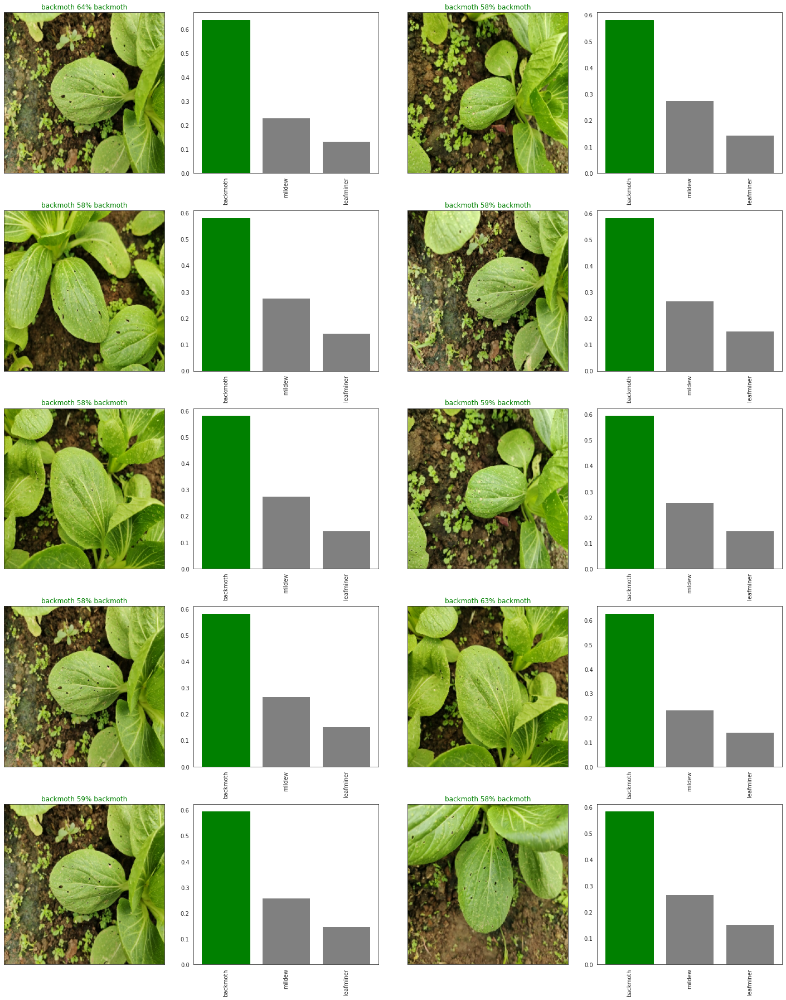

In [44]:
batch_predict(b6_nocrop_pred)

  0%|          | 0/1000 [00:00<?, ?it/s]

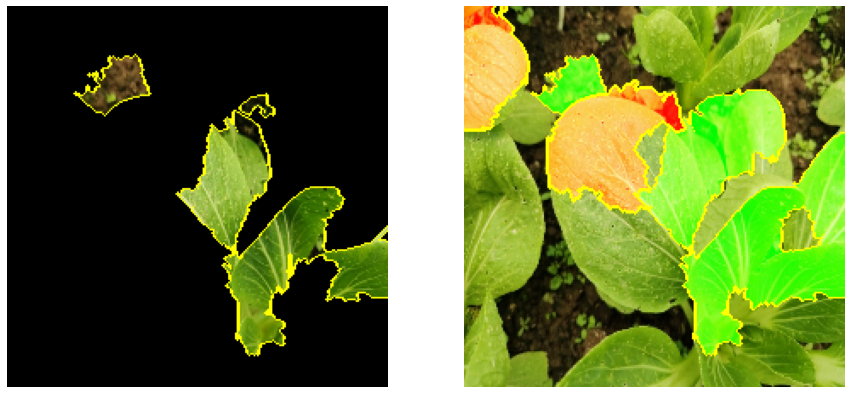

In [45]:
LIME_explanation(b6_nocrop,sample_img)

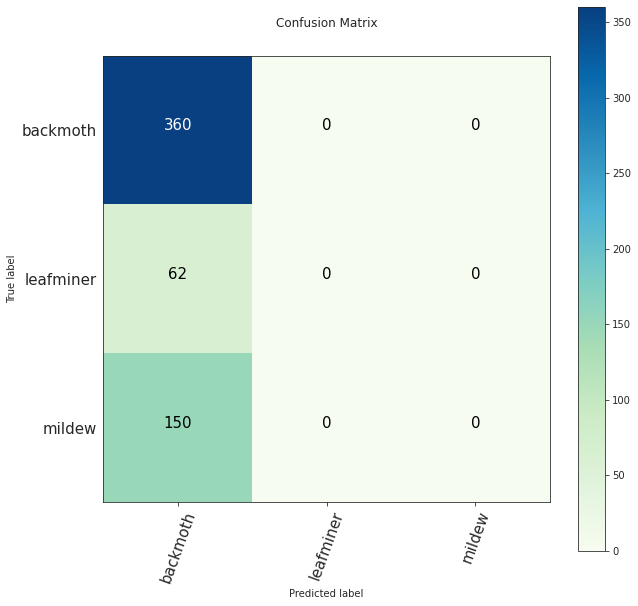

In [46]:
make_confusion_matrix(val_labels, b6_nocrop_pred.argmax(axis=1), classes=val_data.class_names, figsize=(10, 10), text_size=15, norm=False, savefig=False)